In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from scipy import signal
import IPython.display as ipd
import librosa
import pandas as pd
from scipy import signal

In [2]:
def print_plot_play(x, Fs, text=''):
    """1. Prints information about an audio singal, 2. plots the waveform, and 3. Creates player

    Args:
        x: Input signal
        Fs: Sampling rate of x
        text: Text to print
    """
    print('%s Fs = %d, x.shape = %s, x.dtype = %s' % (text, Fs, x.shape, x.dtype))
    fig = plt.figure(figsize=(8, 2))
    ax = fig.add_subplot(111)
    plt.plot(x, color='gray')
    plt.xlim([0, x.shape[0]])
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    plt.tight_layout()
    plt.show()
    ipd.display(ipd.Audio(data=x, rate=Fs))

In [3]:
def print_plot_play_with_label(x, Fs, label, text=''):
    """1. Prints information about an audio singal, 2. plots the waveform, and 3. Creates player

    Args:
        x: Input signal
        Fs: Sampling rate of x
        text: Text to print
    """
    print('%s Fs = %d, x.shape = %s, x.dtype = %s' % (text, Fs, x.shape, x.dtype))
    fig = plt.figure(figsize=(8, 2))
    ax = fig.add_subplot(111)
    start_y = min(x)
    heigh_y = max(x) - min(x)
    for i in range(len(label)):
        start_x = label[i,0] * Fs
        width_x = (label[i,1] -  label[i,0]) * Fs
        rect = Rectangle((start_x,start_y),width_x,heigh_y,linewidth=1,edgecolor='r',facecolor='none')
        ax.add_patch(rect)
    plt.plot(x, color='gray')
    plt.xlim([0, x.shape[0]])
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    plt.tight_layout()
    plt.show()
    ipd.display(ipd.Audio(data=x, rate=Fs))

In [4]:
# from google.colab import drive
# drive.mount('/content/drive')

/tmp/ipykernel_145350/677498941.py:20: UserWarning: PySoundFile failed. Trying audioread instead.
  x, sr = librosa.load(path, sr=None)
/home/shamika/miniconda3/envs/ml311/lib/python3.11/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
/tmp/ipykernel_145350/677498941.py:20: UserWarning: PySoundFile failed. Trying audioread instead.
  x, sr = librosa.load(path, sr=None)
/home/shamika/miniconda3/envs/ml311/lib/python3.11/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
/tmp/ipykernel_145350/677498941.py:20: UserWarning: PySoundFile failed. Trying audioread instead.
  x, sr = librosa.load(path, sr=None)
/hom

knuckle Fs = 48000, x.shape = (3523520,), x.dtype = float32


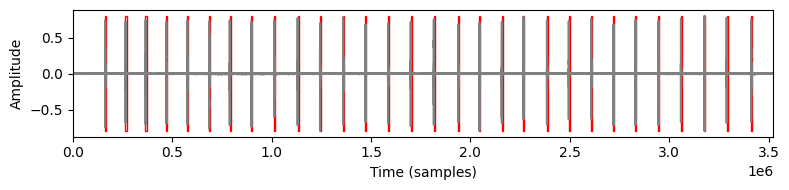

pad Fs = 48000, x.shape = (2630592,), x.dtype = float32


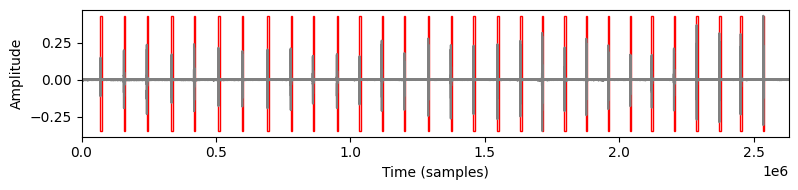

nail_tip_tap Fs = 48000, x.shape = (2442176,), x.dtype = float32


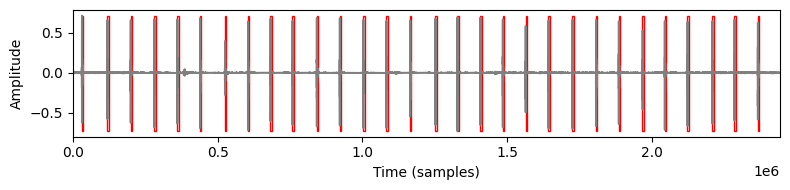

nail_tap Fs = 48000, x.shape = (2601920,), x.dtype = float32


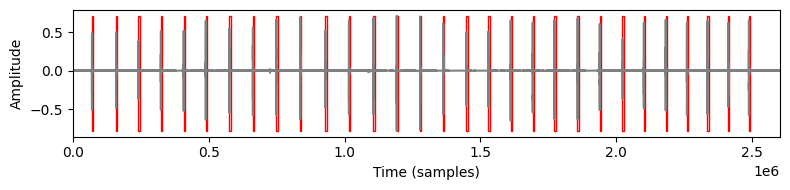

In [5]:
#Read data from audio files and label files

# # Read audio files
# knuckle_file = "./recorded_dataset-shamika/Knuckle.mp3"
# # nail_file = "./recorded_dataset-shamika/Finger nail tip tap.mp3"
# # pad_file = "./audio_file/pad.wav"
# # knuckle_file = "./audio_file/knuckle.wav"
# pad_file = "./audio_file/pad.wav"
# nail_file = "./audio_file/nail.wav"

knuckle_file = "./new_data/Knuckle.m4a"
pad_file = "./new_data/Pad.m4a"
nail_tip_tap_file = "./new_data/Nail tip tap.m4a"
nail_tap_file = "./new_data/Nail tap.m4a"

# Use librosa if available; otherwise fall back to the repo's decoder (ffmpeg/wave).
def load_audio(path):
    try:
        import librosa
        x, sr = librosa.load(path, sr=None)
        return x, sr
    except Exception:
        from scripts.auto_annotate_taps import decode_audio_mono
        x, sr = decode_audio_mono(path, target_sr=None, use_ffmpeg=True)
        return x, sr

knuclke_raw, Fs = load_audio(knuckle_file)
pad_raw, Fs_pad = load_audio(pad_file)
nail_tip_tap_raw, Fs_nail_tip_tap = load_audio(nail_tip_tap_file)
nail_tap_raw, Fs_nail_tap = load_audio(nail_tap_file)
if not (Fs_pad == Fs == Fs_nail_tip_tap == Fs_nail_tap):
    raise ValueError(f"Sample rates differ: knuckle={Fs}, pad={Fs_pad}, nail_tip_tap={Fs_nail_tip_tap}, nail_tap={Fs_nail_tap}")

# Read label files (Audacity format). If missing, auto-generate using scripts/auto_annotate_taps.py logic.
# For new larger datasets, set AUTO_GENERATE_LABELS=True and update EXPECTED_COUNT/FIXED_DUR_MS.
AUTO_GENERATE_LABELS = False
EXPECTED_COUNT = {"knuckle": 10, "pad": 10, "nail_tip_tap": 10, "nail_tap": 10}  # set to None if unknown
FIXED_DUR_MS = {"knuckle": 110, "pad": 95, "nail_tip_tap": 66, "nail_tap": 66}
PRE_MS = 10
MIN_GAP_MS = 120

from pathlib import Path
from scripts.auto_annotate_taps import annotate_taps, write_labels

def ms_to_samples(ms, sr):
    return int(round((ms / 1000.0) * sr))

def ensure_labels(name, x, sr, label_path):
    label_file = Path(label_path)
    if (not label_file.exists()) or AUTO_GENERATE_LABELS:
        segments, _stats = annotate_taps(
            x,
            sr,
            lag=10,
            smooth_win=max(1, ms_to_samples(2.0, sr)),
            env_win=max(1, ms_to_samples(5.0, sr)),
            onset_search=max(1, ms_to_samples(30.0, sr)),
            onset_frac=0.25,
            pre=ms_to_samples(PRE_MS, sr),
            post=0,
            threshold_z=6.0,
            min_gap=ms_to_samples(MIN_GAP_MS, sr),
            boundary_frac=0.10,
            min_dur=ms_to_samples(20.0, sr),
            max_dur=ms_to_samples(150.0, sr),
            fixed_dur=ms_to_samples(FIXED_DUR_MS[name], sr),
            expected_count=EXPECTED_COUNT[name],
        )
        write_labels(str(label_file), segments, sr)
        print(f"[auto-annotate] {name}: wrote {len(segments)} labels -> {label_file}")

# Read label files generated from the Audacity software
knckle_label_file = "./labels/Knuckle.txt"
# pad_label_file = "./recorded_dataset-shamika/4 finger tap.txt"
# nail_label_file = "./recorded_dataset-shamika/Finger nail tip tap.txt"
# knckle_label_file = "./audio_file/knuckle.txt"
pad_label_file = "./labels/Pad.txt"
nail_tap_label_file = "./labels/Nail tap.txt"
nail_tip_tap_label_file = "./labels/Nail tip tap.txt"

ensure_labels("knuckle", knuclke_raw, Fs, knckle_label_file)
ensure_labels("pad", pad_raw, Fs, pad_label_file)
ensure_labels("nail_tip_tap", nail_tip_tap_raw, Fs, nail_tip_tap_label_file)
ensure_labels("nail_tap", nail_tap_raw, Fs, nail_tap_label_file)

knckle_label = np.loadtxt(knckle_label_file, delimiter='\t', skiprows=0)
pad_label = np.loadtxt(pad_label_file, delimiter='\t', skiprows=0)
nail_tip_tap_label = np.loadtxt(nail_tip_tap_label_file, delimiter='\t', skiprows=0)
nail_tap_label = np.loadtxt(nail_tap_label_file, delimiter='\t', skiprows=0)

# Ensure label arrays are always 2D (even if a file has only one row)
knckle_label = np.atleast_2d(knckle_label)
pad_label = np.atleast_2d(pad_label)
nail_tip_tap_label = np.atleast_2d(nail_tip_tap_label)
nail_tap_label = np.atleast_2d(nail_tap_label)


print_plot_play_with_label(knuclke_raw, Fs, knckle_label, text='knuckle')
print_plot_play_with_label(pad_raw, Fs, pad_label, text='pad')
print_plot_play_with_label(nail_tip_tap_raw, Fs, nail_tip_tap_label, text='nail_tip_tap')
print_plot_play_with_label(nail_tap_raw, Fs, nail_tap_label, text='nail_tap')

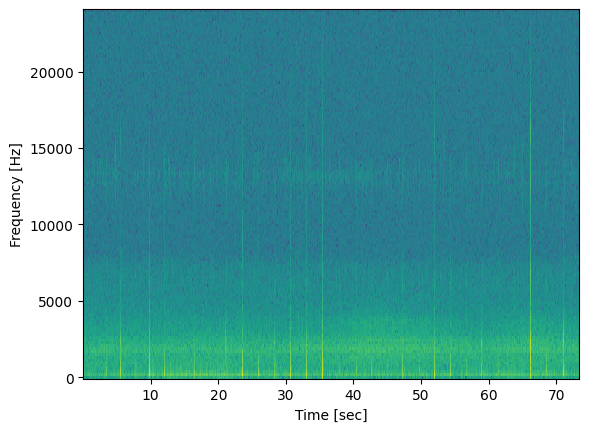

In [6]:
f, t, Sxx = signal.spectrogram(knuclke_raw, Fs)
plt.pcolormesh(t, f, 10*np.log10(Sxx))
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.show()

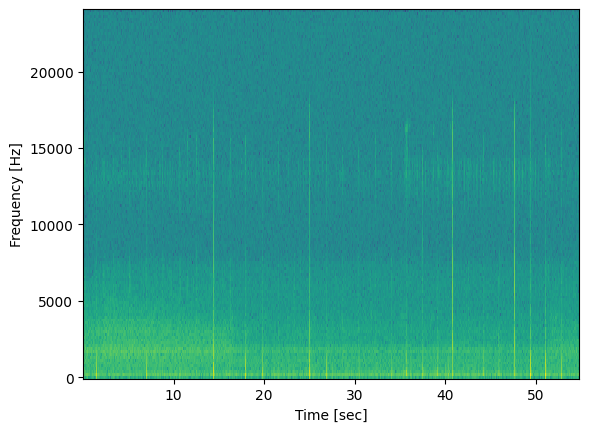

In [7]:
f, t, Sxx = signal.spectrogram(pad_raw, Fs)
plt.pcolormesh(t, f, 10*np.log10(Sxx))
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.show()

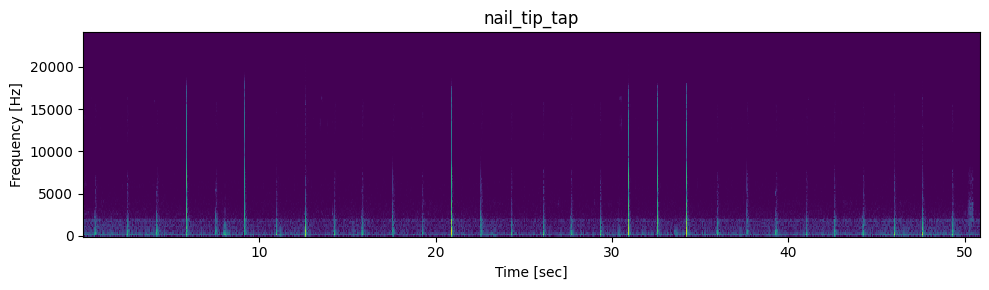

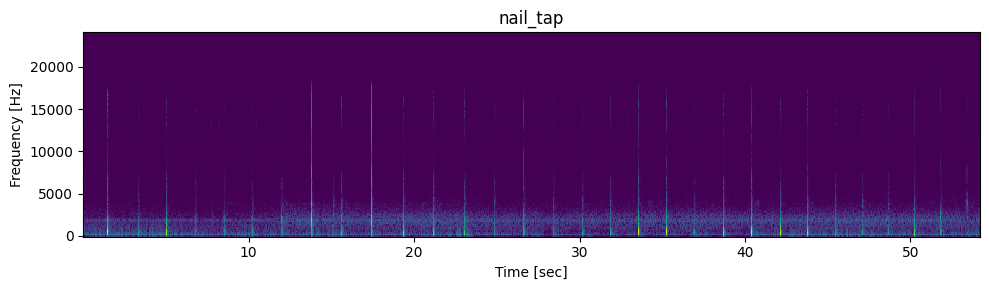

In [8]:

# Spectrograms (nail tip tap vs nail tap)
for name, x in [("nail_tip_tap", nail_tip_tap_raw), ("nail_tap", nail_tap_raw)]:
    f, t, Sxx = signal.spectrogram(x, Fs)
    plt.figure(figsize=(10, 3))
    plt.pcolormesh(t, f, 10*np.log10(Sxx + 1e-12), shading='auto')
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.title(name)
    plt.tight_layout()
    plt.show()


In [9]:
# Develop a auto segmentation method
# Step 1: get manually segmented data samples
# Step 2: feature engineering
# Step 3: build the program for auto segmentation
# Step 4: test the performance

In [10]:

# Step 1: get manually segmented data samples
knuckle_samples = []
for i in range(len(knckle_label)):
    start_index = int(knckle_label[i,0] * Fs)
    end_index = int(knckle_label[i,1] * Fs)
    knuckle_samples.append(knuclke_raw[start_index:end_index])

pad_samples = []
for i in range(len(pad_label)):
    start_index = int(pad_label[i,0] * Fs)
    end_index = int(pad_label[i,1] * Fs)
    pad_samples.append(pad_raw[start_index:end_index])

nail_tip_tap_samples = []
for i in range(len(nail_tip_tap_label)):
    start_index = int(nail_tip_tap_label[i,0] * Fs)
    end_index = int(nail_tip_tap_label[i,1] * Fs)
    nail_tip_tap_samples.append(nail_tip_tap_raw[start_index:end_index])

nail_tap_samples = []
for i in range(len(nail_tap_label)):
    start_index = int(nail_tap_label[i,0] * Fs)
    end_index = int(nail_tap_label[i,1] * Fs)
    nail_tap_samples.append(nail_tap_raw[start_index:end_index])


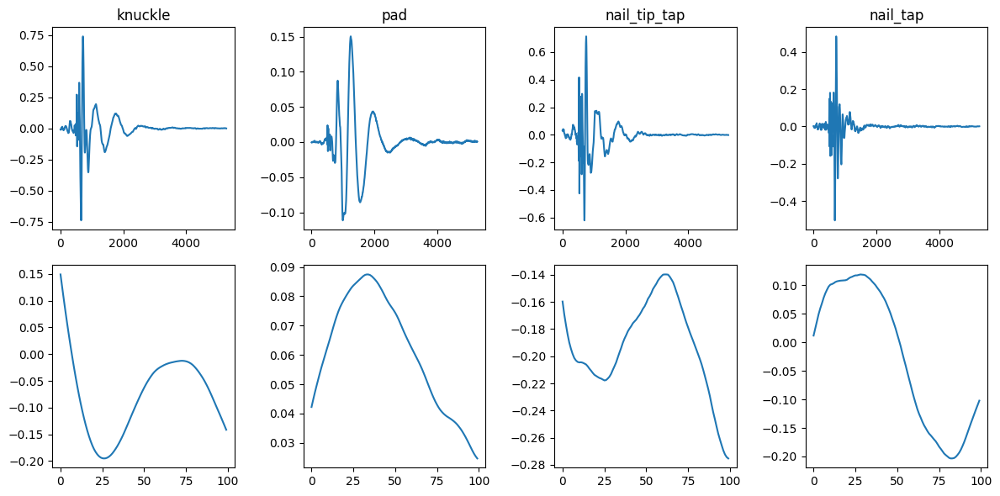

In [11]:

# Step 2: feature engineering (visualize 4 gesture samples)
plt.figure(figsize=(12, 6))

plt.subplot(2,4,1)
plt.plot(knuckle_samples[0])
plt.title('knuckle')
plt.subplot(2,4,5)
plt.plot(knuckle_samples[0][750:850])

plt.subplot(2,4,2)
plt.plot(pad_samples[0])
plt.title('pad')
plt.subplot(2,4,6)
plt.plot(pad_samples[0][800:900])

plt.subplot(2,4,3)
plt.plot(nail_tip_tap_samples[0])
plt.title('nail_tip_tap')
plt.subplot(2,4,7)
plt.plot(nail_tip_tap_samples[0][800:900])

plt.subplot(2,4,4)
plt.plot(nail_tap_samples[0])
plt.title('nail_tap')
plt.subplot(2,4,8)
plt.plot(nail_tap_samples[0][800:900])

plt.tight_layout()
plt.show()


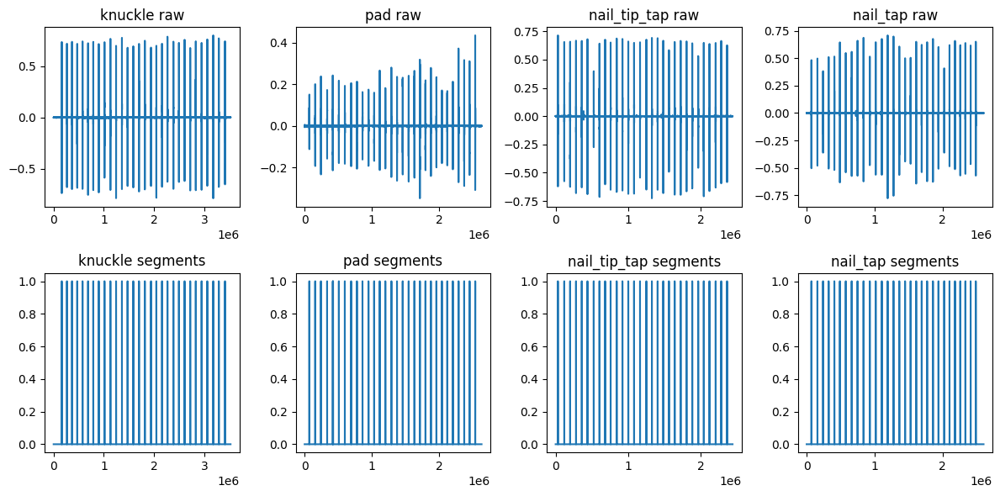

In [12]:

# Step 3: build the program for auto segmentation
plt.figure(figsize=(12, 6))

plt.subplot(2,4,1)
plt.plot(knuclke_raw)
plt.title('knuckle raw')

plt.subplot(2,4,2)
plt.plot(pad_raw)
plt.title('pad raw')

plt.subplot(2,4,3)
plt.plot(nail_tip_tap_raw)
plt.title('nail_tip_tap raw')

plt.subplot(2,4,4)
plt.plot(nail_tap_raw)
plt.title('nail_tap raw')


def identify_edge_index(data, thresh):
    data_size = len(data)
    temp = np.zeros(data_size)
    res = np.zeros(data_size)
    res_index = []
    start = 10
    for i in range(start, data_size):
        if data[i] - data[i-start] > thresh:
            temp[i] = 1
        else:
            temp[i] = 0

        if i > 350 and temp[i] == 1 and sum(temp[i-350: i]) == 0:
            res[i] = 1
            res_index.append(i)
        else:
            res[i] = 0

    return res, res_index


seg_knuckle, seg_index_knuckle = identify_edge_index(knuclke_raw, 0.2)
plt.subplot(2,4,5)
plt.plot(seg_knuckle)
plt.title('knuckle segments')

seg_pad, seg_index_pad = identify_edge_index(pad_raw, 0.012)
plt.subplot(2,4,6)
plt.plot(seg_pad)
plt.title('pad segments')

# NOTE: thresholds for nail_tip_tap vs nail_tap may differ; start with same default.
seg_nail_tip_tap, seg_index_nail_tip_tap = identify_edge_index(nail_tip_tap_raw, 0.12)
plt.subplot(2,4,7)
plt.plot(seg_nail_tip_tap)
plt.title('nail_tip_tap segments')

seg_nail_tap, seg_index_nail_tap = identify_edge_index(nail_tap_raw, 0.12)
plt.subplot(2,4,8)
plt.plot(seg_nail_tap)
plt.title('nail_tap segments')

plt.tight_layout()
plt.show()


In [13]:

# Step 2: Sample length
# We would using a moving window for event detection
# get the average windows length
knuckle_sample_len = ((knckle_label[:,1] -  knckle_label[:,0]) * Fs).astype(int)
pad_sample_len = ((pad_label[:,1] -  pad_label[:,0]) * Fs).astype(int)
nail_tip_tap_sample_len = ((nail_tip_tap_label[:,1] -  nail_tip_tap_label[:,0]) * Fs).astype(int)
nail_tap_sample_len = ((nail_tap_label[:,1] -  nail_tap_label[:,0]) * Fs).astype(int)

print('knuckle mean len:', np.mean(knuckle_sample_len))
print('pad mean len:', np.mean(pad_sample_len))
print('nail_tip_tap mean len:', np.mean(nail_tip_tap_sample_len))
print('nail_tap mean len:', np.mean(nail_tap_sample_len))


knuckle mean len: 5279.1
pad mean len: 5279.166666666667
nail_tip_tap mean len: 5279.166666666667
nail_tap mean len: 5279.3


Sample - 0


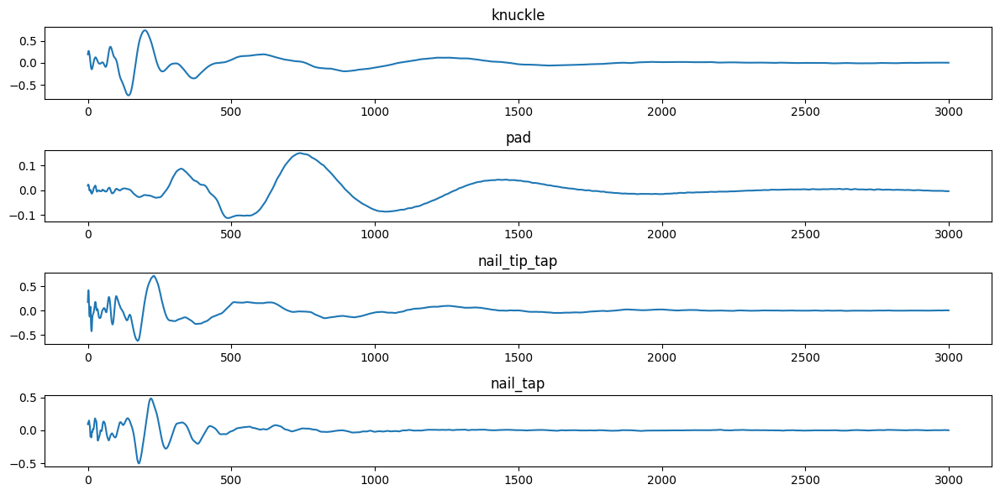

In [14]:

# Show some results
window_len = 3000

knuckle_sample = knuclke_raw[seg_index_knuckle[0]:(seg_index_knuckle[0] + window_len)]
pad_sample = pad_raw[seg_index_pad[0]:(seg_index_pad[0] + window_len)]
nail_tip_tap_sample = nail_tip_tap_raw[seg_index_nail_tip_tap[0]:(seg_index_nail_tip_tap[0] + window_len)]
nail_tap_sample = nail_tap_raw[seg_index_nail_tap[0]:(seg_index_nail_tap[0] + window_len)]

print("Sample - {0}".format(0))
plt.figure(figsize=(12, 6))

plt.subplot(4,1,1)
plt.plot(knuckle_sample)
plt.title('knuckle')

plt.subplot(4,1,2)
plt.plot(pad_sample)
plt.title('pad')

plt.subplot(4,1,3)
plt.plot(nail_tip_tap_sample)
plt.title('nail_tip_tap')

plt.subplot(4,1,4)
plt.plot(nail_tap_sample)
plt.title('nail_tap')

plt.tight_layout()
plt.show()


In [15]:
# Classification
# Step 1: feature engineering
# Step 2: build the classifier
# Step 3: evaluation

In [16]:

# FFT features of all samples
window_len = 3000

knuckle_sample_array = []
pad_sample_array = []
nail_tip_tap_sample_array = []
nail_tap_sample_array = []

def build_fft_features(raw, seg_indices, window_len, max_bins=9999):
    features = []
    for start in seg_indices:
        end = min(start + window_len, len(raw))
        sample = raw[start:end]
        if len(sample) < window_len:
            sample = np.pad(sample, (0, window_len - len(sample)), mode='constant')

        sp = np.fft.fft(sample, Fs)
        fft_values = sp.real
        fft_power = np.abs(fft_values) / len(sample)
        features.append(fft_power[0:max_bins].tolist())
    return features

print('Detected segments - knuckle: {}, pad: {}, nail_tip_tap: {}, nail_tap: {}'.format(
    len(seg_index_knuckle), len(seg_index_pad), len(seg_index_nail_tip_tap), len(seg_index_nail_tap)
))

knuckle_sample_array = build_fft_features(knuclke_raw, seg_index_knuckle, window_len)
pad_sample_array = build_fft_features(pad_raw, seg_index_pad, window_len)
nail_tip_tap_sample_array = build_fft_features(nail_tip_tap_raw, seg_index_nail_tip_tap, window_len)
nail_tap_sample_array = build_fft_features(nail_tap_raw, seg_index_nail_tap, window_len)

print('FFT feature counts - knuckle: {}, pad: {}, nail_tip_tap: {}, nail_tap: {}'.format(
    len(knuckle_sample_array), len(pad_sample_array), len(nail_tip_tap_sample_array), len(nail_tap_sample_array)
))


Detected segments - knuckle: 30, pad: 37, nail_tip_tap: 30, nail_tap: 30
FFT feature counts - knuckle: 30, pad: 37, nail_tip_tap: 30, nail_tap: 30


In [17]:
# Build the classifier
# Method-1: the rule way
# This is your homework - 1


## Method 1: Rule-based classifier via spectral template matching

This baseline uses **template matching in the frequency domain**.
Each gesture is represented by the magnitude of its FFT, and a single **template** (prototype spectrum) is computed per gesture from the training set.
A new sample is classified as the gesture whose template is most similar to its spectrum.

### 1) Feature representation
For each segmented audio tap, we compute the FFT magnitude vector:

$$
x = |\mathrm{FFT}(s)| \in \mathbb{R}^d
$$

where $s$ is the 1‑D audio segment and $d$ is the number of frequency bins kept.

### 2) Build gesture templates (class prototypes)
For each gesture class
$g \in \{	ext{knuckle},\; 	ext{pad},\; 	ext{nail\_tip\_tap},\; 	ext{nail\_tap}\}$,
we form a template by averaging all training spectra of that class:

$$
\mu_g = 
rac{1}{N_g}\sum_{i=1}^{N_g} x_i^{(g)}
$$

where $N_g$ is the number of training samples for gesture $g$.

### 3) Similarity measure (cosine similarity)
Given a new sample spectrum $x$, we compute cosine similarity to each template:

$$
\mathrm{cos}(x,\mu_g) =

rac{x^	op \mu_g}{\|x\|\;\|\mu_g\| + 
arepsilon}
$$

with a small $
arepsilon$ (e.g., $10^{-8}$) to avoid division by zero.

### 4) Decision rule
We assign the label of the template with the highest similarity:

$$
\hat{y} = rg\max_{g}\; \mathrm{cos}(x,\mu_g)
$$

Intuitively, the classifier predicts the gesture whose **average spectral fingerprint** best matches the incoming tap.

This method is fully deterministic: no learned model parameters beyond the per-class mean spectra.


In [18]:

# ---------- Method-1: Rule-based classifier (template matching) ----------

import numpy as np
from sklearn.metrics import accuracy_score

# Build train feature matrix and labels from the FFT features
X_train = np.array(
    knuckle_sample_array + pad_sample_array + nail_tip_tap_sample_array + nail_tap_sample_array
)
y_train = np.array(
    [0] * len(knuckle_sample_array)
    + [1] * len(pad_sample_array)
    + [2] * len(nail_tip_tap_sample_array)
    + [3] * len(nail_tap_sample_array)
)

label_names = {0: "knuckle", 1: "pad", 2: "nail_tip_tap", 3: "nail_tap"}

# Class "templates" = average spectrum per gesture
knuckle_template      = np.mean(np.vstack(knuckle_sample_array), axis=0)
pad_template          = np.mean(np.vstack(pad_sample_array), axis=0)
nail_tip_tap_template = np.mean(np.vstack(nail_tip_tap_sample_array), axis=0)
nail_tap_template     = np.mean(np.vstack(nail_tap_sample_array), axis=0)

def cosine_sim(a, b, eps=1e-8):
    a = np.asarray(a)
    b = np.asarray(b)
    return float(np.dot(a, b) / ((np.linalg.norm(a) * np.linalg.norm(b)) + eps))

def rule_based_predict_one(x_fft):
    sims = [
        cosine_sim(x_fft, knuckle_template),
        cosine_sim(x_fft, pad_template),
        cosine_sim(x_fft, nail_tip_tap_template),
        cosine_sim(x_fft, nail_tap_template),
    ]
    return int(np.argmax(sims))   # 0 / 1 / 2 / 3

def rule_based_predict(X):
    return np.array([rule_based_predict_one(x) for x in X])

# Sanity check on the training set
rb_train_pred = rule_based_predict(X_train)
print("Rule-based TRAIN accuracy:", accuracy_score(y_train, rb_train_pred))


Rule-based TRAIN accuracy: 0.9606299212598425


In [19]:
# # Method-2: the ML way
# # This is your homework - 1
# from sklearn import svm
# X = knuckle_sample_array[0:-1]
# X.extend(pad_sample_array[0:-1])
# X.extend(nail_tip_tap_sample_array[0:-1])
# X.extend(nail_tap_sample_array[0:-1])

# y = [0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,2,2,2,2,2,2,2,2,2]
# clf = svm.SVC()
# clf.fit(X, y)



## Method-2: the ML way (k-NN)

This method uses a **k-nearest neighbors (k-NN)** classifier on the same FFT feature vectors.

- **Input features**: the FFT magnitude vectors (same as Method‑1).
- **Classifier**: `KNeighborsClassifier(n_neighbors=3)` from scikit‑learn (Euclidean distance by default).
- **Evaluation**: a stratified train/validation split is used to estimate how well the classifier works on held-out segments.

Because k-NN is instance-based, performance can depend strongly on how representative the training samples are and how well the feature vectors are normalized.


In [20]:
# Method-2: the ML way (k-NN instead of SVM)

from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Reuse X_train, y_train defined in Method-1
X_tr, X_val, y_tr, y_val = train_test_split(
    X_train, y_train,
    test_size=0.3,
    random_state=42,
    stratify=y_train,
)

knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_tr, y_tr)

y_val_pred = knn.predict(X_val)
print("kNN VALIDATION accuracy:", accuracy_score(y_val, y_val_pred))
print("kNN validation confusion matrix:\n", confusion_matrix(y_val, y_val_pred))
print("kNN validation classification report:\n",
      classification_report(y_val, y_val_pred, target_names=[label_names[i] for i in range(4)]))


kNN VALIDATION accuracy: 1.0
kNN validation confusion matrix:
 [[ 9  0  0  0]
 [ 0 12  0  0]
 [ 0  0  9  0]
 [ 0  0  0  9]]
kNN validation classification report:
               precision    recall  f1-score   support

     knuckle       1.00      1.00      1.00         9
         pad       1.00      1.00      1.00        12
nail_tip_tap       1.00      1.00      1.00         9
    nail_tap       1.00      1.00      1.00         9

    accuracy                           1.00        39
   macro avg       1.00      1.00      1.00        39
weighted avg       1.00      1.00      1.00        39



In [21]:

# Step 4: evaluate on separate TEST audio files (optional)
# Provide these 4 files if you want a true held-out test.

from pathlib import Path

knuckle_test_file = "./audio_file/knuckle-test.wav"
pad_test_file = "./audio_file/pad-test.wav"
nail_tip_tap_test_file = "./audio_file/nail-tip-tap-test.wav"
nail_tap_test_file = "./audio_file/nail-tap-test.wav"

test_files = {
    "knuckle": knuckle_test_file,
    "pad": pad_test_file,
    "nail_tip_tap": nail_tip_tap_test_file,
    "nail_tap": nail_tap_test_file,
}

missing = [name for name, p in test_files.items() if not Path(p).exists()]
RUN_TEST_EVAL = (len(missing) == 0)

if not RUN_TEST_EVAL:
    print("Skipping TEST evaluation; missing files:", missing)
else:
    knuclke_test_raw, Fs = load_audio(knuckle_test_file)
    pad_test_raw, Fs_pad_test = load_audio(pad_test_file)
    nail_tip_tap_test_raw, Fs_nail_tip_tap_test = load_audio(nail_tip_tap_test_file)
    nail_tap_test_raw, Fs_nail_tap_test = load_audio(nail_tap_test_file)

    if not (Fs_pad_test == Fs == Fs_nail_tip_tap_test == Fs_nail_tap_test):
        raise ValueError(
            f"Sample rates differ: knuckle_test={Fs}, pad_test={Fs_pad_test}, nail_tip_tap_test={Fs_nail_tip_tap_test}, nail_tap_test={Fs_nail_tap_test}"
        )

    plt.figure(figsize=(12, 6))

    plt.subplot(2,4,1)
    plt.plot(knuclke_test_raw)
    plt.title('knuckle test raw')

    plt.subplot(2,4,2)
    plt.plot(pad_test_raw)
    plt.title('pad test raw')

    plt.subplot(2,4,3)
    plt.plot(nail_tip_tap_test_raw)
    plt.title('nail_tip_tap test raw')

    plt.subplot(2,4,4)
    plt.plot(nail_tap_test_raw)
    plt.title('nail_tap test raw')

    def identify_edge_index(data, thresh):
        data_size = len(data)
        temp = np.zeros(data_size)
        res = np.zeros(data_size)
        res_index = []
        start = 10
        for i in range(start, data_size):
            if data[i] - data[i-start] > thresh:
                temp[i] = 1
            else:
                temp[i] = 0

            if i > 350 and temp[i] == 1 and sum(temp[i-350: i]) == 0:
                res[i] = 1
                res_index.append(i)
            else:
                res[i] = 0

        return res, res_index

    seg_knuckle_test, seg_index_knuckle_test = identify_edge_index(knuclke_test_raw, 0.1)
    plt.subplot(2,4,5)
    plt.plot(seg_knuckle_test)
    plt.title('knuckle test segments')

    seg_pad_test, seg_index_pad_test = identify_edge_index(pad_test_raw, 0.012)
    plt.subplot(2,4,6)
    plt.plot(seg_pad_test)
    plt.title('pad test segments')

    seg_nail_tip_tap_test, seg_index_nail_tip_tap_test = identify_edge_index(nail_tip_tap_test_raw, 0.12)
    plt.subplot(2,4,7)
    plt.plot(seg_nail_tip_tap_test)
    plt.title('nail_tip_tap test segments')

    seg_nail_tap_test, seg_index_nail_tap_test = identify_edge_index(nail_tap_test_raw, 0.12)
    plt.subplot(2,4,8)
    plt.plot(seg_nail_tap_test)
    plt.title('nail_tap test segments')

    plt.tight_layout()
    plt.show()


Skipping TEST evaluation; missing files: ['nail_tip_tap', 'nail_tap']


In [22]:

# FFT features of TEST samples
window_len = 3000

if not RUN_TEST_EVAL:
    print('Skipping TEST FFT feature extraction (missing test files).')
else:
    knuckle_sample_array_test = build_fft_features(knuclke_test_raw, seg_index_knuckle_test, window_len)
    pad_sample_array_test = build_fft_features(pad_test_raw, seg_index_pad_test, window_len)
    nail_tip_tap_sample_array_test = build_fft_features(nail_tip_tap_test_raw, seg_index_nail_tip_tap_test, window_len)
    nail_tap_sample_array_test = build_fft_features(nail_tap_test_raw, seg_index_nail_tap_test, window_len)

    print('TEST FFT feature counts - knuckle: {}, pad: {}, nail_tip_tap: {}, nail_tap: {}'.format(
        len(knuckle_sample_array_test), len(pad_sample_array_test), len(nail_tip_tap_sample_array_test), len(nail_tap_sample_array_test)
    ))


Skipping TEST FFT feature extraction (missing test files).


In [23]:

# (Optional) If you had a trained sklearn model 'clf', you could run:
# clf.predict(nail_tip_tap_sample_array_test)
# clf.predict(nail_tap_sample_array_test)


In [24]:

# ---------- Evaluate both methods on the TEST audio ----------

from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

if not RUN_TEST_EVAL:
    print('Skipping TEST evaluation (missing test files).')
else:
    X_test = np.array(
        knuckle_sample_array_test
        + pad_sample_array_test
        + nail_tip_tap_sample_array_test
        + nail_tap_sample_array_test
    )
    y_test = np.array(
        [0] * len(knuckle_sample_array_test)
        + [1] * len(pad_sample_array_test)
        + [2] * len(nail_tip_tap_sample_array_test)
        + [3] * len(nail_tap_sample_array_test)
    )

    print('Test X shape:', X_test.shape)
    print('Test y shape:', y_test.shape)

    # Rule-based method
    rb_test_pred = rule_based_predict(X_test)
    print('Rule-based TEST accuracy:', accuracy_score(y_test, rb_test_pred))
    print('Rule-based confusion matrix:', confusion_matrix(y_test, rb_test_pred))
    print('Rule-based classification report:',
          classification_report(y_test, rb_test_pred, target_names=[label_names[i] for i in range(4)]))

    # k-NN method
    knn_test_pred = knn.predict(X_test)
    print('kNN TEST accuracy:', accuracy_score(y_test, knn_test_pred))
    print('kNN confusion matrix:', confusion_matrix(y_test, knn_test_pred))
    print('kNN classification report:',
          classification_report(y_test, knn_test_pred, target_names=[label_names[i] for i in range(4)]))


Skipping TEST evaluation (missing test files).



# Dataset Size Exploration

This section explores how the size of the training dataset affects the performance of both classifiers.

**Important:** when you do not have separate, truly independent test recordings, the notebook falls back to a **holdout split** from the extracted FFT features (`X_full`, `y_full`).

- If external `X_test/y_test` exist (built from separate test audio files), the sweep evaluates on that.
- Otherwise it creates a stratified holdout test split from `X_full/y_full` and evaluates on that.


In [25]:
# Setup for dataset size exploration
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

print("="*60)
print("EXPLORING EFFECT OF DATASET SIZE ON PERFORMANCE")
print("="*60)

EXPLORING EFFECT OF DATASET SIZE ON PERFORMANCE


In [26]:

# Build complete feature matrix from training data
X_full = np.array(knuckle_sample_array + pad_sample_array + nail_tip_tap_sample_array + nail_tap_sample_array)
y_full = np.array(
    [0] * len(knuckle_sample_array) +
    [1] * len(pad_sample_array) +
    [2] * len(nail_tip_tap_sample_array) +
    [3] * len(nail_tap_sample_array)
)

print(f"Total training samples: {len(X_full)}")
print(f"Feature dimensions: {X_full.shape[1]}")
if "X_test" in globals():
    print(f"Test samples: {len(X_test)}")
else:
    print("Test samples: (not defined yet; run the holdout/test cell)")


Total training samples: 127
Feature dimensions: 9999
Test samples: (not defined yet; run the holdout/test cell)


In [27]:

# Define dataset size percentages to test
# This section evaluates generalization either on:
#   - external TEST audio (if you created X_test/y_test earlier), OR
#   - a holdout split from the extracted training features (fallback).

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.neighbors import KNeighborsClassifier

# Holdout configuration (used only if X_test/y_test are not already defined)
HOLDOUT_TEST_SIZE = 0.30
SPLIT_MODE = 'stratified'  # 'stratified' or 'chronological'
RANDOM_STATE = 42

# If no external test set exists, create a holdout test set from X_full/y_full.
if ('X_test' not in globals()) or ('y_test' not in globals()):
    print('No external X_test/y_test found; creating a holdout split from X_full/y_full...')

    if SPLIT_MODE == 'stratified':
        X_train_full, X_test, y_train_full, y_test = train_test_split(
            X_full,
            y_full,
            test_size=HOLDOUT_TEST_SIZE,
            random_state=RANDOM_STATE,
            stratify=y_full,
        )
    elif SPLIT_MODE == 'chronological':
        # Per-class chronological split: take the last HOLDOUT_TEST_SIZE fraction as test.
        X_train_parts, y_train_parts, X_test_parts, y_test_parts = [], [], [], []
        for cls in range(4):
            idxs = np.where(y_full == cls)[0]
            # preserve original order
            idxs = np.sort(idxs)
            n = len(idxs)
            n_test = max(1, int(round(n * HOLDOUT_TEST_SIZE)))
            test_idxs = idxs[-n_test:]
            train_idxs = idxs[:-n_test]
            X_train_parts.append(X_full[train_idxs])
            y_train_parts.append(y_full[train_idxs])
            X_test_parts.append(X_full[test_idxs])
            y_test_parts.append(y_full[test_idxs])

        X_train_full = np.vstack(X_train_parts)
        y_train_full = np.concatenate(y_train_parts)
        X_test = np.vstack(X_test_parts)
        y_test = np.concatenate(y_test_parts)
    else:
        raise ValueError(f'Unknown SPLIT_MODE: {SPLIT_MODE!r}')

else:
    # External test set exists; train split is the full extracted training set.
    X_train_full, y_train_full = X_full, y_full

print('Train size:', len(y_train_full), ' Test size:', len(y_test))
print('Train class counts:', {label_names[i]: int(np.sum(y_train_full == i)) for i in range(4)})
print('Test  class counts:', {label_names[i]: int(np.sum(y_test == i)) for i in range(4)})


dataset_sizes = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

# Store results
rule_based_train_acc = []
rule_based_test_acc = []
knn_train_acc = []
knn_test_acc = []
actual_sample_counts = []

# Store confusion matrices and classification reports for later inspection
rb_test_conf_mats = []
knn_test_conf_mats = []
rb_test_reports = []
knn_test_reports = []

# Helper function for cosine similarity
def cosine_sim(a, b, eps=1e-8):
    a = np.asarray(a)
    b = np.asarray(b)
    return float(np.dot(a, b) / ((np.linalg.norm(a) * np.linalg.norm(b)) + eps))

for size in dataset_sizes:
    print(f"\n--- Testing with {int(size*100)}% of TRAINING data ---")

    # Sample the TRAIN split only (never sample from X_test)
    if size < 1.0:
        X_subset, _, y_subset, _ = train_test_split(
            X_train_full, y_train_full, train_size=size, random_state=RANDOM_STATE, stratify=y_train_full
        )
    else:
        X_subset = X_train_full
        y_subset = y_train_full

    actual_sample_counts.append(len(X_subset))
    print(f"Training samples used: {len(X_subset)}")

    # ===== Rule-based Classifier (Template Matching) =====
    # Build templates from subset
    knuckle_indices = np.where(y_subset == 0)[0]
    pad_indices = np.where(y_subset == 1)[0]
    nail_tip_tap_indices = np.where(y_subset == 2)[0]
    nail_tap_indices = np.where(y_subset == 3)[0]

    knuckle_template = np.mean(X_subset[knuckle_indices], axis=0)
    pad_template = np.mean(X_subset[pad_indices], axis=0)
    nail_tip_tap_template = np.mean(X_subset[nail_tip_tap_indices], axis=0)
    nail_tap_template = np.mean(X_subset[nail_tap_indices], axis=0)

    def rule_based_predict(X):
        predictions = []
        for x in X:
            sims = [
                cosine_sim(x, knuckle_template),
                cosine_sim(x, pad_template),
                cosine_sim(x, nail_tip_tap_template),
                cosine_sim(x, nail_tap_template),
            ]
            predictions.append(int(np.argmax(sims)))
        return np.array(predictions)

    # Evaluate rule-based
    rb_train_pred = rule_based_predict(X_subset)
    rb_test_pred = rule_based_predict(X_test)

    rb_train_accuracy = accuracy_score(y_subset, rb_train_pred)
    rb_test_accuracy = accuracy_score(y_test, rb_test_pred)

    rule_based_train_acc.append(rb_train_accuracy)
    rule_based_test_acc.append(rb_test_accuracy)

    rb_test_conf_mats.append(confusion_matrix(y_test, rb_test_pred, labels=list(range(4))))
    rb_test_reports.append(
        classification_report(
            y_test,
            rb_test_pred,
            labels=list(range(4)),
            target_names=[label_names[i] for i in range(4)],
            zero_division=0,
        )
    )

    print(f"Rule-based - Train: {rb_train_accuracy:.3f}, Test: {rb_test_accuracy:.3f}")

    # ===== k-NN Classifier =====
    knn = KNeighborsClassifier(n_neighbors=3)
    knn.fit(X_subset, y_subset)

    knn_train_pred = knn.predict(X_subset)
    knn_test_pred = knn.predict(X_test)

    knn_train_accuracy = accuracy_score(y_subset, knn_train_pred)
    knn_test_accuracy = accuracy_score(y_test, knn_test_pred)

    knn_train_acc.append(knn_train_accuracy)
    knn_test_acc.append(knn_test_accuracy)

    knn_test_conf_mats.append(confusion_matrix(y_test, knn_test_pred, labels=list(range(4))))
    knn_test_reports.append(
        classification_report(
            y_test,
            knn_test_pred,
            labels=list(range(4)),
            target_names=[label_names[i] for i in range(4)],
            zero_division=0,
        )
    )

    print(f"k-NN - Train: {knn_train_accuracy:.3f}, Test: {knn_test_accuracy:.3f}")


No external X_test/y_test found; creating a holdout split from X_full/y_full...
Train size: 88  Test size: 39
Train class counts: {'knuckle': 21, 'pad': 25, 'nail_tip_tap': 21, 'nail_tap': 21}
Test  class counts: {'knuckle': 9, 'pad': 12, 'nail_tip_tap': 9, 'nail_tap': 9}

--- Testing with 10% of TRAINING data ---
Training samples used: 8
Rule-based - Train: 1.000, Test: 0.744
k-NN - Train: 0.875, Test: 0.846

--- Testing with 20% of TRAINING data ---
Training samples used: 17
Rule-based - Train: 1.000, Test: 0.974
k-NN - Train: 0.941, Test: 0.974

--- Testing with 30% of TRAINING data ---
Training samples used: 26
Rule-based - Train: 1.000, Test: 0.974
k-NN - Train: 0.923, Test: 0.974

--- Testing with 40% of TRAINING data ---
Training samples used: 35
Rule-based - Train: 1.000, Test: 1.000
k-NN - Train: 1.000, Test: 1.000

--- Testing with 50% of TRAINING data ---
Training samples used: 44
Rule-based - Train: 0.977, Test: 1.000
k-NN - Train: 1.000, Test: 1.000

--- Testing with 60% o


## Visualize Results

The plots below show **test accuracy vs. training dataset size** for:

- the rule-based template matcher, and
- the k-NN classifier.

Accuracy is reported on the evaluation split used in this section (external test set if provided; otherwise a holdout split).


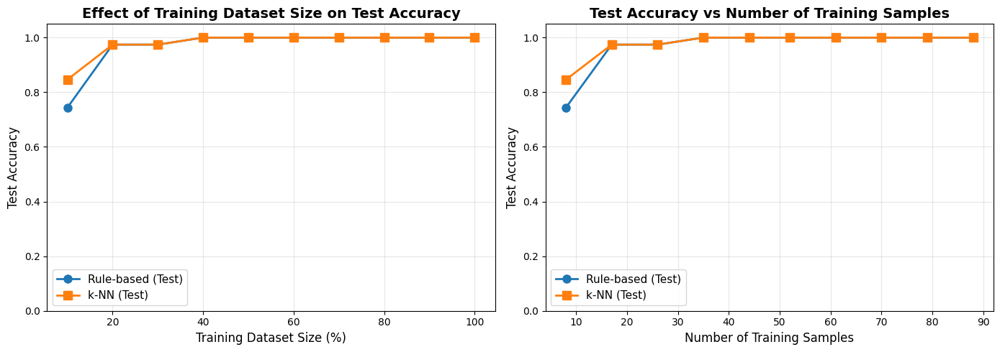


Visualization complete!


In [28]:
# Create visualization
plt.figure(figsize=(14, 5))

# Plot 1: Accuracy vs Dataset Size Percentage
plt.subplot(1, 2, 1)
plt.plot([s*100 for s in dataset_sizes], rule_based_test_acc, 'o-', 
         label='Rule-based (Test)', linewidth=2, markersize=8)
plt.plot([s*100 for s in dataset_sizes], knn_test_acc, 's-', 
         label='k-NN (Test)', linewidth=2, markersize=8)
plt.xlabel('Training Dataset Size (%)', fontsize=12)
plt.ylabel('Test Accuracy', fontsize=12)
plt.title('Effect of Training Dataset Size on Test Accuracy', fontsize=14, fontweight='bold')
plt.legend(fontsize=11)
plt.grid(True, alpha=0.3)
plt.ylim([0, 1.05])

# Plot 2: Accuracy vs Actual Sample Count
plt.subplot(1, 2, 2)
plt.plot(actual_sample_counts, rule_based_test_acc, 'o-', 
         label='Rule-based (Test)', linewidth=2, markersize=8)
plt.plot(actual_sample_counts, knn_test_acc, 's-', 
         label='k-NN (Test)', linewidth=2, markersize=8)
plt.xlabel('Number of Training Samples', fontsize=12)
plt.ylabel('Test Accuracy', fontsize=12)
plt.title('Test Accuracy vs Number of Training Samples', fontsize=14, fontweight='bold')
plt.legend(fontsize=11)
plt.grid(True, alpha=0.3)
plt.ylim([0, 1.05])

plt.tight_layout()
plt.show()

print("\nVisualization complete!")


## Summary Results

The table summarizes test accuracy for each training dataset size.

For the **best** rule-based run and the **best** k-NN run, the notebook also prints:

- the confusion matrix (rows=true class, columns=predicted), and
- the per-class precision/recall/F1 classification report.


In [29]:

# Print summary statistics
print("="*60)
print("SUMMARY RESULTS")
print("="*60)

print("Dataset Size Effects on Test Accuracy:")
print("-" * 60)
print(f"{'Size (%)':>10} {'Samples':>10} {'Rule-based':>15} {'k-NN':>15}")
print("-" * 60)
for i, size in enumerate(dataset_sizes):
    print(f"{size*100:>10.0f} {actual_sample_counts[i]:>10} "
          f"{rule_based_test_acc[i]:>15.3f} {knn_test_acc[i]:>15.3f}")

best_rb_i = int(np.argmax(rule_based_test_acc))
best_knn_i = int(np.argmax(knn_test_acc))

print("" + "="*60)
print(f"Best Rule-based Accuracy: {rule_based_test_acc[best_rb_i]:.3f} at {dataset_sizes[best_rb_i]*100:.0f}% of data")
print(f"Best k-NN Accuracy: {knn_test_acc[best_knn_i]:.3f} at {dataset_sizes[best_knn_i]*100:.0f}% of data")
print("="*60)

print("Best Rule-based confusion matrix (rows=true, cols=pred; labels 0..3):")
print(rb_test_conf_mats[best_rb_i])
print("Best Rule-based classification report:")
print(rb_test_reports[best_rb_i])

print("Best k-NN confusion matrix (rows=true, cols=pred; labels 0..3):")
print(knn_test_conf_mats[best_knn_i])
print("Best k-NN classification report:")
print(knn_test_reports[best_knn_i])


SUMMARY RESULTS
Dataset Size Effects on Test Accuracy:
------------------------------------------------------------
  Size (%)    Samples      Rule-based            k-NN
------------------------------------------------------------
        10          8           0.744           0.846
        20         17           0.974           0.974
        30         26           0.974           0.974
        40         35           1.000           1.000
        50         44           1.000           1.000
        60         52           1.000           1.000
        70         61           1.000           1.000
        80         70           1.000           1.000
        90         79           1.000           1.000
       100         88           1.000           1.000
Best Rule-based Accuracy: 1.000 at 40% of data
Best k-NN Accuracy: 1.000 at 40% of data
Best Rule-based confusion matrix (rows=true, cols=pred; labels 0..3):
[[ 9  0  0  0]
 [ 0 12  0  0]
 [ 0  0  9  0]
 [ 0  0  0  9]]
Best Rule-


## Key Observations

1. **Validation vs test**: Perfect validation accuracy can happen when train/validation segments come from the same recording conditions. A holdout split is better than nothing, but a truly independent test recording is the most realistic evaluation.

2. **Rule-based vs k-NN**: The template matcher can work well with fewer samples; k-NN often benefits from more data but may plateau if the features do not separate classes well under distribution shift.

3. **Use confusion matrices**: Look at per-class recall to see which gestures are being confused (commonly `nail_tip_tap` vs `nail_tap`).

4. **If test performance is low**: improve onset alignment/segmentation thresholds and consider normalizing features (e.g., log-magnitude, per-sample normalization) before classification.
